Based on https://github.com/facebookresearch/segment-anything/blob/main/notebooks/predictor_example.ipynb 

In [1]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2
import nibabel as nib
from scipy import ndimage

In [2]:
using_colab = True

In [3]:
if using_colab:
    import torch
    import torchvision
    print("PyTorch version:", torch.__version__)
    print("Torchvision version:", torchvision.__version__)
    print("CUDA is available:", torch.cuda.is_available())
    import sys
    !{sys.executable} -m pip install opencv-python matplotlib
    !{sys.executable} -m pip install 'git+https://github.com/facebookresearch/segment-anything.git'
    !wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth

PyTorch version: 2.0.0+cu118
Torchvision version: 0.15.1+cu118
CUDA is available: True
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-sevwjxyi
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-sevwjxyi
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 567662b0fd33ca4b022d94d3b8de896628cd32dd
  Preparing metadata (setup.py) ... done
  Created wheel for segment-anything: filename=segment_anything-1.0-py3-none-any.whl size=36610 sha256=8f872ad9c7b7aa8f7a0bb44b62e75f3af556646df1f3e52fcc9480f294913c80
  Stored in directory: /tmp/pip-ephem-wheel-cache-8xe6dul0/wheels/d5/11/03/7aca746a2c0e09f279b10436ced7175926bc38f650b736a648
Successfully built segm

In [7]:
import sys
sys.path.append("..")
from segment_anything import sam_model_registry, SamPredictor

sam_checkpoint = "sam_vit_h_4b8939.pth"
model_type = "vit_h"

device = "cuda"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

predictor = SamPredictor(sam)

In [8]:
def convert(img, target_type_min, target_type_max, target_type):
    imin = img.min()
    imax = img.max()

    a = (target_type_max - target_type_min) / (imax - imin)
    b = target_type_max - a * imax
    new_img = (a * img + b).astype(target_type)
    return new_img
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)
    
def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)   
    
def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))    

7T t2s test

[215 198 279 282]


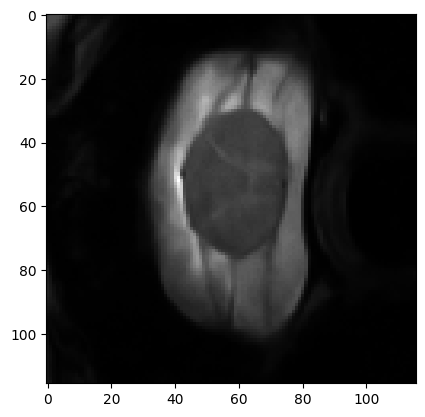

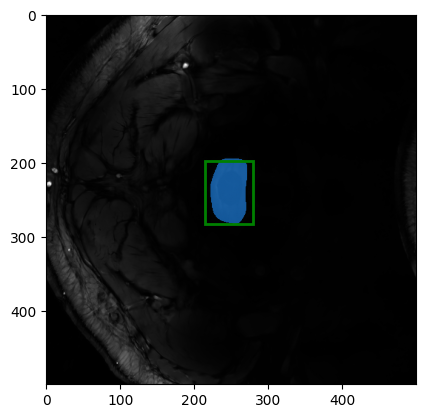

[215 198 279 282]


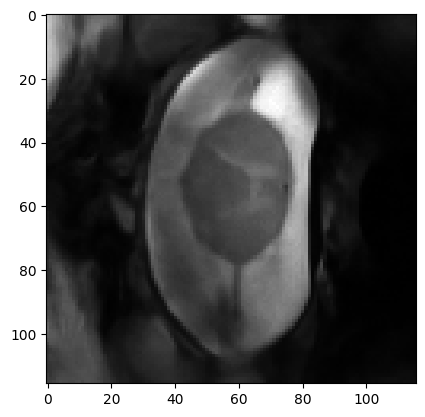

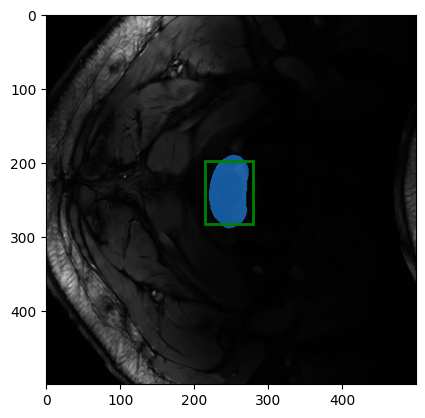

[212 201 276 285]


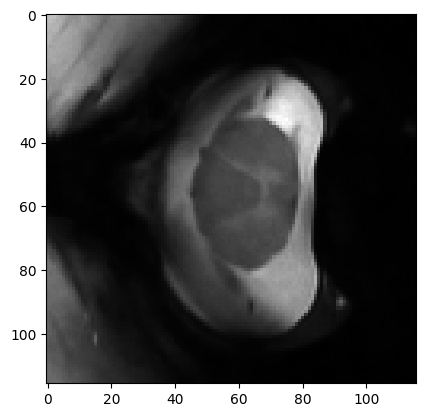

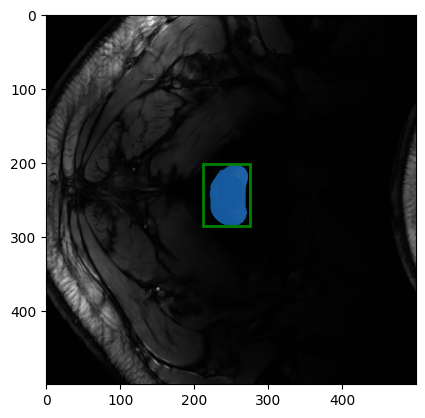

[216 202 280 286]


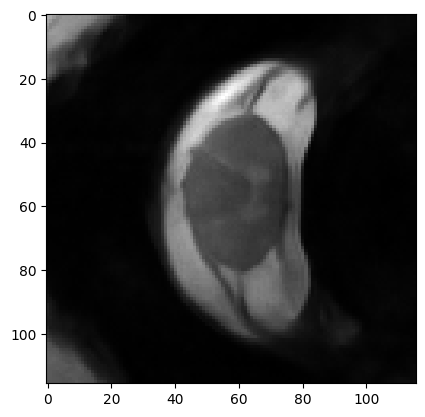

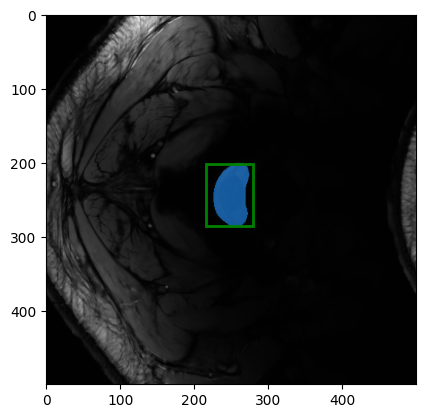

[219 201 283 285]


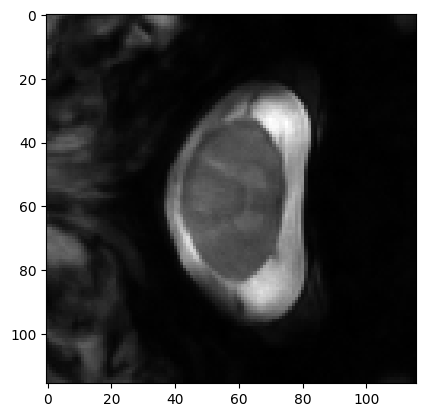

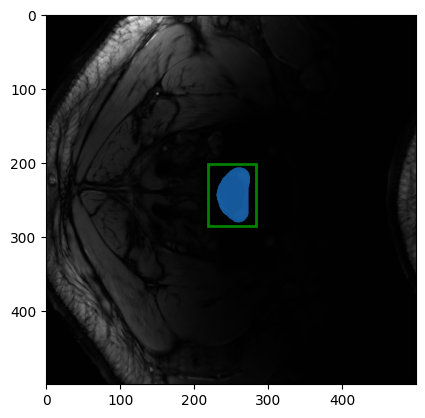

[220 202 284 286]


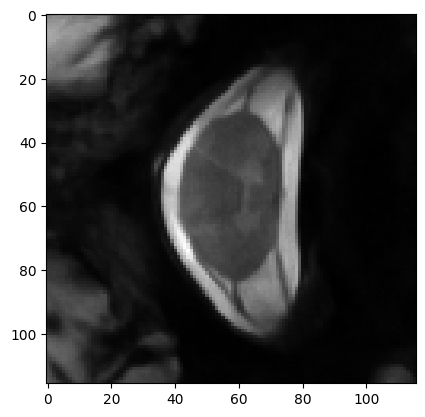

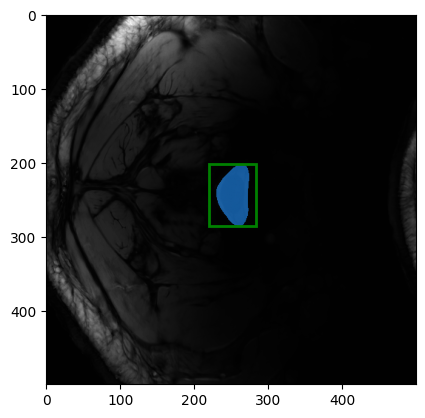

[223 205 287 289]


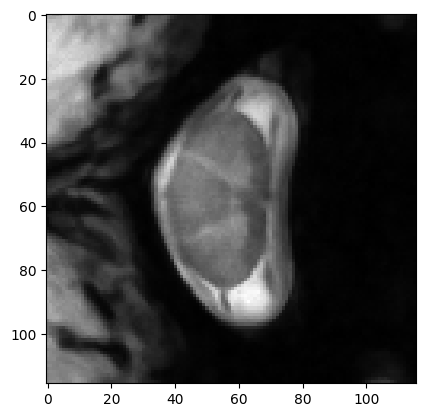

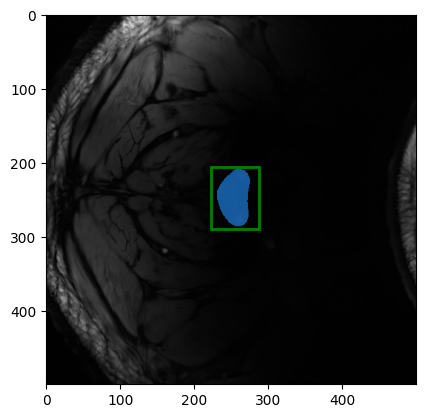

[223 202 287 286]


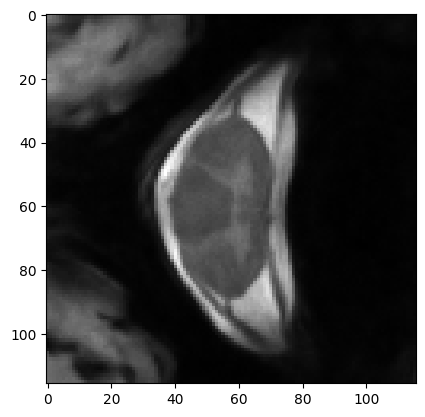

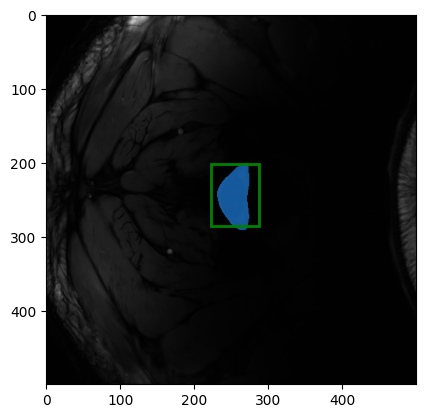

[223 198 287 282]


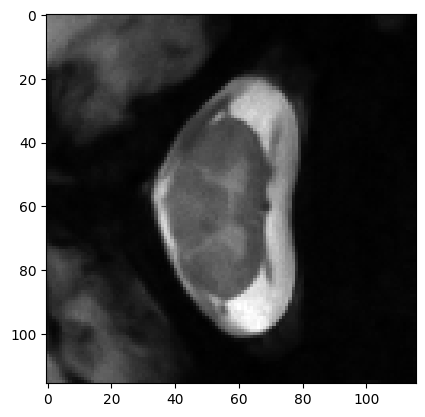

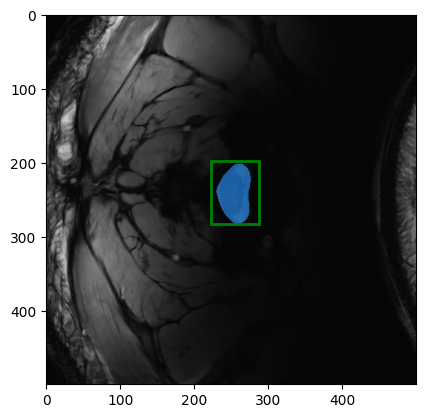

[216 202 280 286]


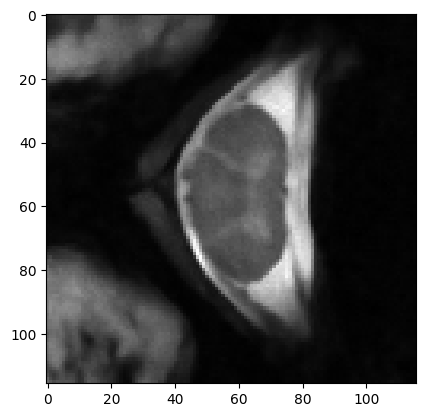

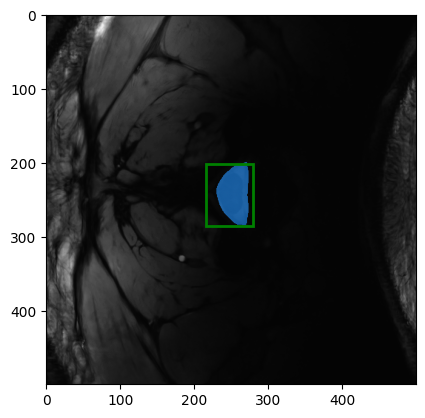

[220 194 284 278]


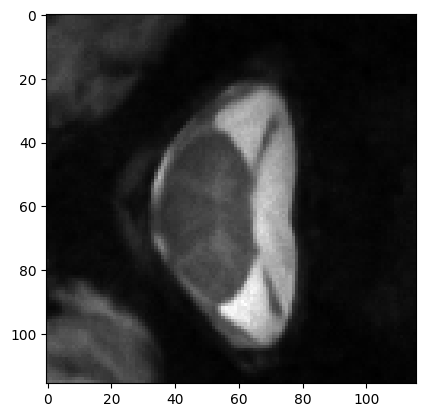

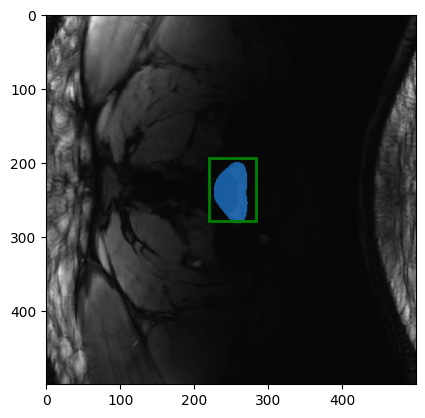

[212 201 276 285]


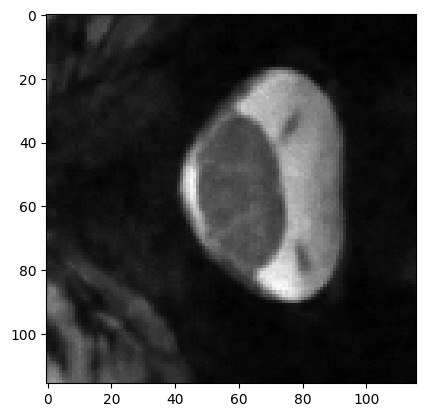

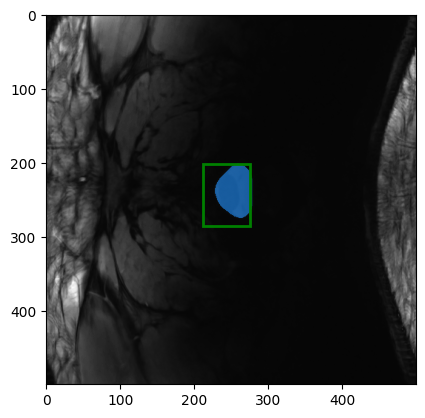

In [23]:
image_data = nib.load('nl_session_2_medic.nii.gz' )
header_data = image_data.header
image_sc = np.array(image_data.get_fdata())
image_center = nib.load('nl_session_2_medic_centerline.nii.gz' )
image_center = np.array(image_center.get_fdata())

res=float(header_data["pixdim"][2])
n= int(30/res)
Size_X=(image_sc.shape)[0]
Size_Y=(image_sc.shape)[1]
Size_Z=(image_sc.shape)[2]
image_csf=np.zeros((Size_X,Size_Y,Size_Z))
for i in range ((image_sc.shape)[2]):
    image_sc_2d=image_sc[:,:,i]
    image_center_2d=image_center[:,:,i]
    for l in range(len(image_center_2d[:,0])):
        for m in range( len(image_center_2d[0,:])):
            if image_center_2d[l,m] == 1 :
                a,b=(l,m)
    cmin = a - int(n/2)
    cmax = a + int(n/2)
    dmin = b - int(n/2)
    dmax = b + int(n/2)
    factor_x = int(((dmax-dmin) - 16/res )/2)
    factor_y = int(((dmax-dmin) - 21/res )/2)
    input_box = np.array([dmin + factor_x, cmin + factor_y, dmax - factor_x ,cmax - factor_y])
    #print(input_box)
    imgu8 = convert(image_sc_2d, 0, 255, np.uint8)
    image_sc_2d_rgb = cv2.merge([imgu8,imgu8,imgu8])
    predictor.set_image(image_sc_2d_rgb)
    masks, _, _ = predictor.predict(    point_coords=None,
    point_labels=None,    box=input_box[None, :],    multimask_output=False,)
    image_csf[:,:,i]=(masks[0])
    plt.gray()
    plt.imshow(image_sc_2d[cmin:cmax,dmin:dmax])
    plt.show()
    plt.imshow(image_sc_2d)
    show_mask(masks[0], plt.gca())
    show_box(input_box, plt.gca())
    plt.show()

In [25]:
84*res 

21.504001021385193

3T t2s test

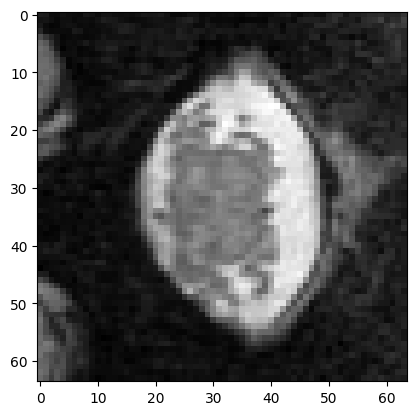

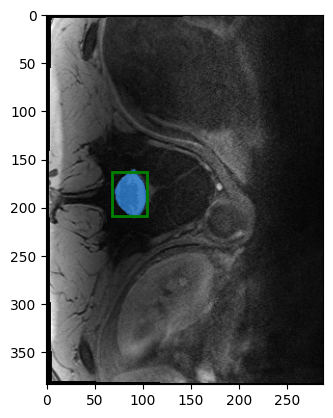

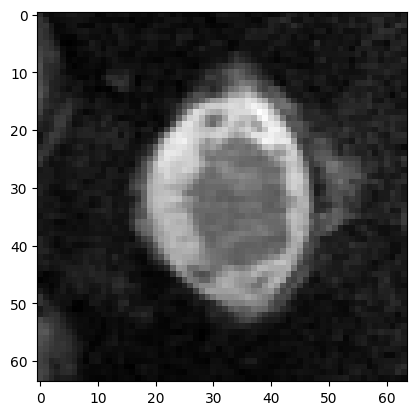

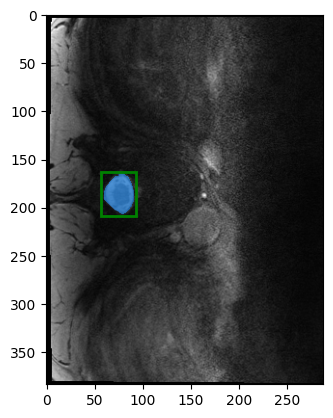

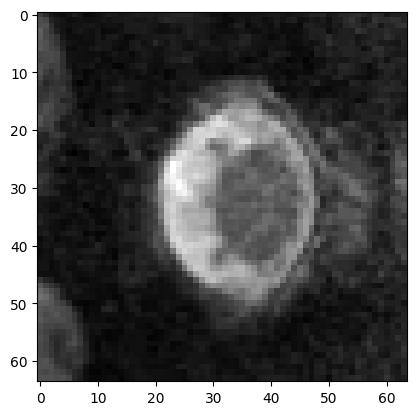

...

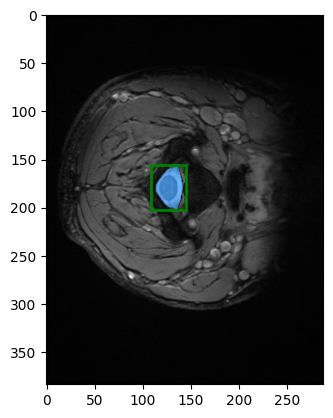

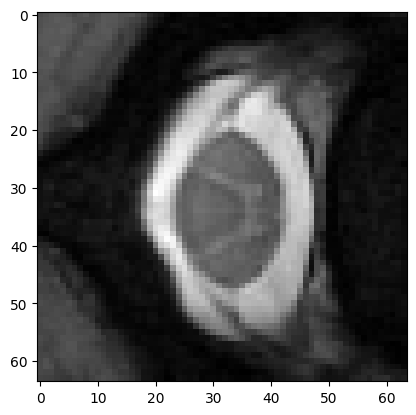

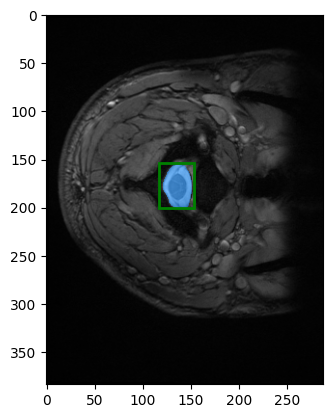

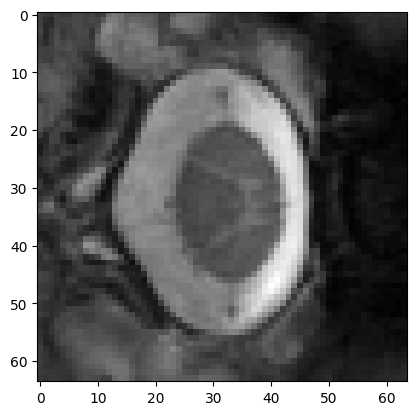

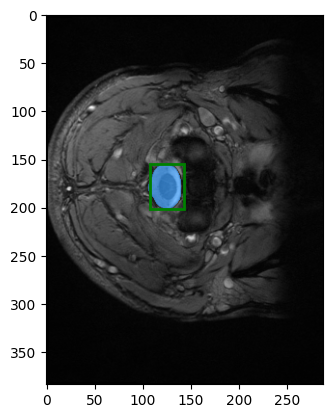

In [ ]:
image_data = nib.load('sub_01_3d.nii.gz' )
header_data = image_data.header
image_sc = np.array(image_data.get_fdata())
image_center = nib.load('sub_01_3d_centerline.nii.gz' )
image_center = np.array(image_center.get_fdata())

res=float(header_data["pixdim"][2])
n= int(30/res)
Size_X=(image_sc.shape)[0]
Size_Y=(image_sc.shape)[1]
Size_Z=(image_sc.shape)[2]
image_csf=np.zeros((Size_X,Size_Y,Size_Z))
for i in range ((image_sc.shape)[2]):
    image_sc_2d=image_sc[:,:,i]
    image_center_2d=image_center[:,:,i]
    for l in range(len(image_center_2d[:,0])):
        for m in range( len(image_center_2d[0,:])):
            if image_center_2d[l,m] == 1 :
                a,b=(l,m)
    cmin = a - int(n/2)
    cmax = a + int(n/2)
    dmin = b - int(n/2)
    dmax = b + int(n/2)
    factor_x = int(((dmax-dmin) - 16/res )/2)
    factor_y = int(((dmax-dmin) - 21/res )/2)
    input_box = np.array([dmin + factor_x, cmin + factor_y, dmax - factor_x ,cmax - factor_y])
    imgu8 = convert(image_sc_2d, 0, 255, np.uint8)
    image_sc_2d_rgb = cv2.merge([imgu8,imgu8,imgu8])
    predictor.set_image(image_sc_2d_rgb)
    masks, _, _ = predictor.predict(    point_coords=None,
    point_labels=None,    box=input_box[None, :],    multimask_output=False,)
    image_csf[:,:,i]=(masks[0])
    plt.gray()
    plt.imshow(image_sc_2d[cmin:cmax,dmin:dmax])
    plt.show()
    plt.imshow(image_sc_2d)
    show_mask(masks[0], plt.gca())
    show_box(input_box, plt.gca())
    plt.show()

In [ ]:
to_save = nib.Nifti1Image(image_csf, image_data.affine, header_data)    
nib.save(to_save,'image_csf_7t_3d.nii.gz')

MPRAGE brain acquisition 

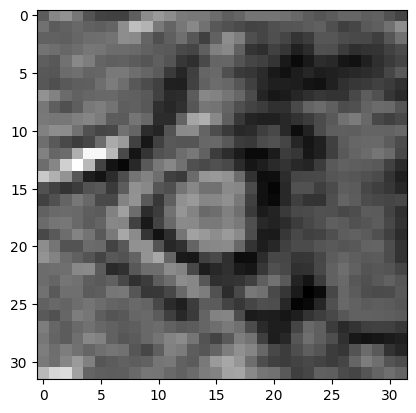

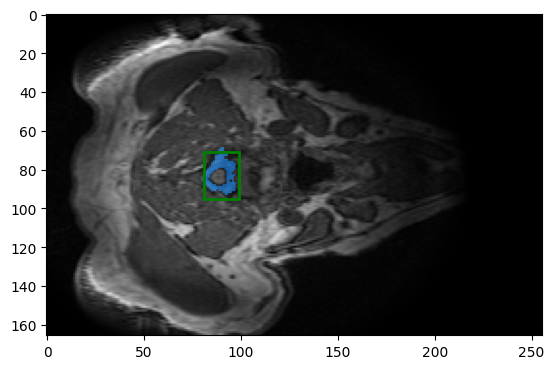

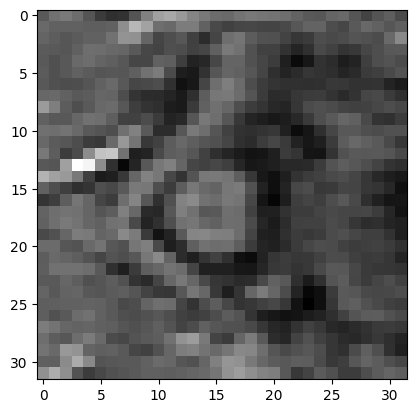

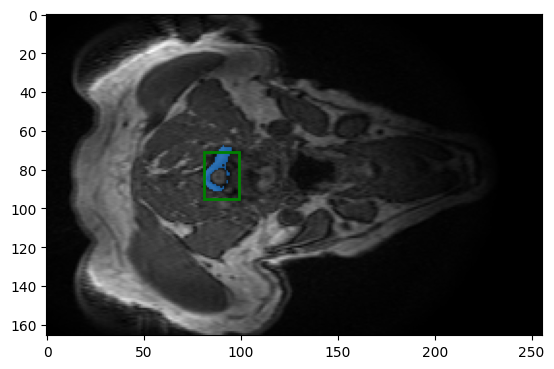

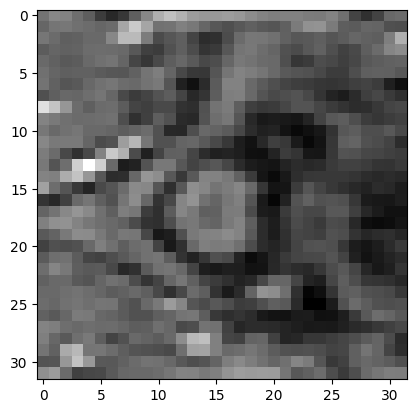

...

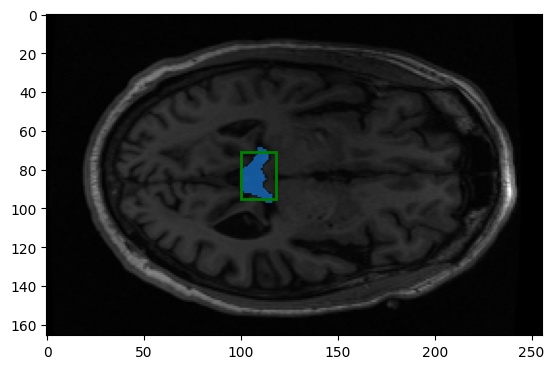

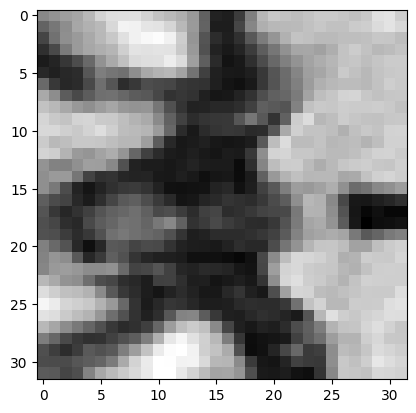

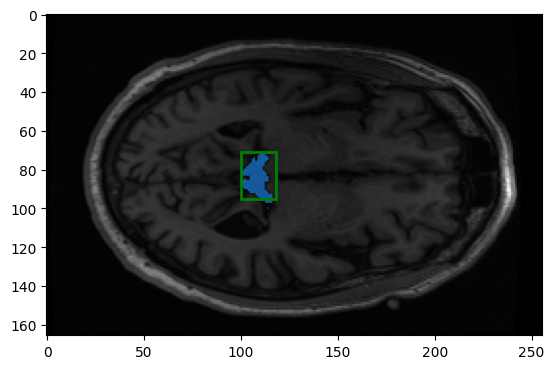

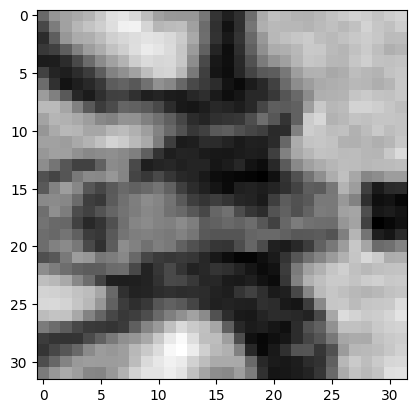

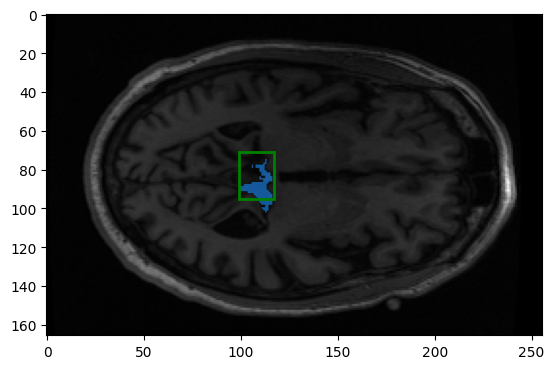

KeyboardInterrupt: ignored

In [18]:
image_data = nib.load('mri.nii.gz' )
header_data = image_data.header
image_sc = np.array(image_data.get_fdata())
image_center = nib.load('mri_centerline.nii.gz' )
image_center = np.array(image_center.get_fdata())

res=float(header_data["pixdim"][2])
n= int(30/res)
Size_X=(image_sc.shape)[0]
Size_Y=(image_sc.shape)[1]
Size_Z=(image_sc.shape)[2]
image_csf=np.zeros((Size_X,Size_Y,Size_Z))
for i in range ((image_sc.shape)[2]):
    image_sc_2d=image_sc[:,:,i]
    image_center_2d=image_center[:,:,i]
    for l in range(len(image_center_2d[:,0])):
        for m in range( len(image_center_2d[0,:])):
            if image_center_2d[l,m] == 1 :
                a,b=(l,m)
    cmin = a - int(n/2)
    cmax = a + int(n/2)
    dmin = b - int(n/2)
    dmax = b + int(n/2)
    factor_x = int(((dmax-dmin) - 16/res )/2)
    factor_y = int(((dmax-dmin) - 21/res )/2)
    input_box = np.array([dmin + factor_x, cmin + factor_y, dmax - factor_x ,cmax - factor_y])
    input_point =  np.array([[int(b), int(a)]])
    input_label = np.array([0])
    imgu8 = convert(image_sc_2d, 0, 255, np.uint8)
    image_sc_2d_rgb = cv2.merge([imgu8,imgu8,imgu8])
    predictor.set_image(image_sc_2d_rgb)
    masks, _, _ = predictor.predict(    point_coords=input_point,    point_labels=input_label,    box=input_box,     multimask_output=False,)
    image_csf[:,:,i]=(masks[0])
    plt.gray()
    plt.imshow(image_sc_2d[cmin:cmax,dmin:dmax])
    plt.show()
    plt.imshow(image_sc_2d)
    show_mask(masks[0], plt.gca())
    show_box(input_box, plt.gca())
    plt.show()

Try to exclude the SC

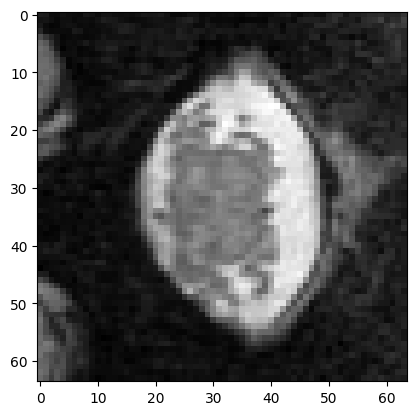

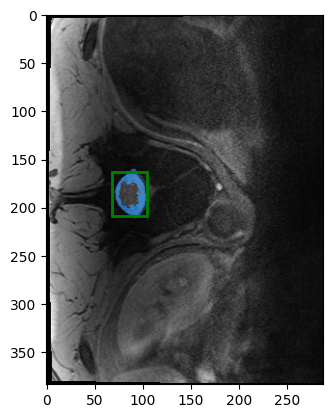

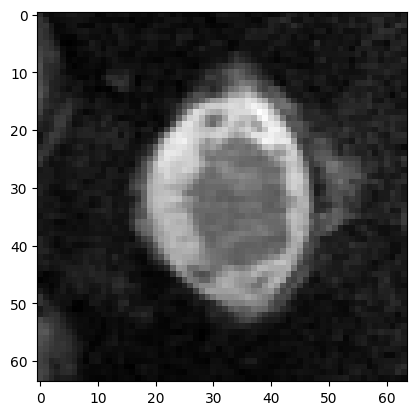

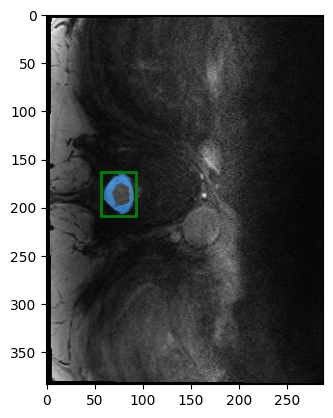

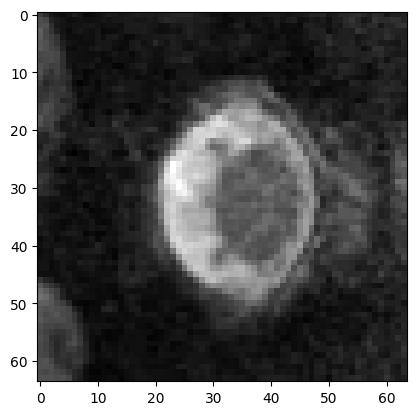

...

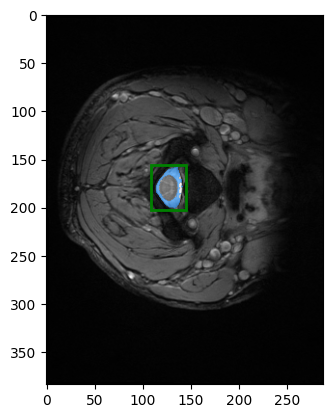

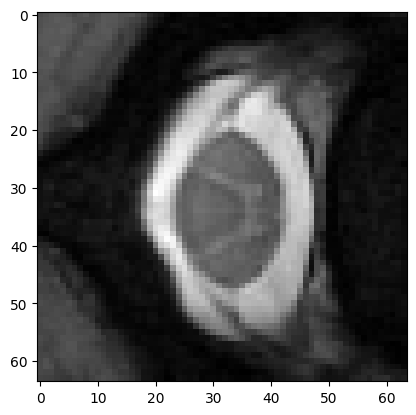

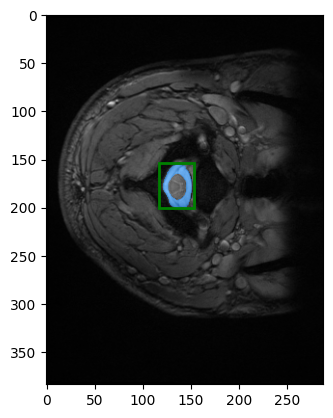

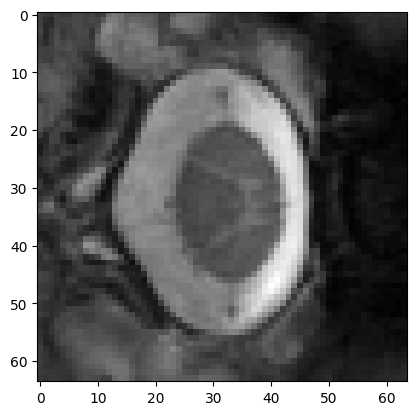

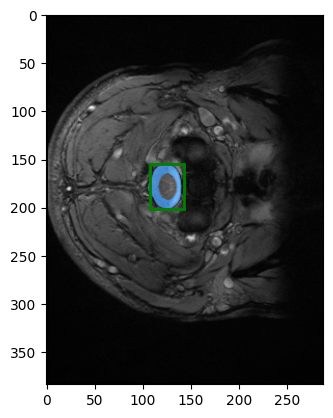

In [ ]:
image_data = nib.load('sub_01_3d.nii.gz' )
header_data = image_data.header
image_sc = np.array(image_data.get_fdata())
image_center = nib.load('sub_01_3d_centerline.nii.gz' )
image_center = np.array(image_center.get_fdata())

res=float(header_data["pixdim"][2])
n= int(30/res)
Size_X=(image_sc.shape)[0]
Size_Y=(image_sc.shape)[1]
Size_Z=(image_sc.shape)[2]
image_csf=np.zeros((Size_X,Size_Y,Size_Z))
for i in range ((image_sc.shape)[2]):
    image_sc_2d=image_sc[:,:,i]
    image_center_2d=image_center[:,:,i]
    for l in range(len(image_center_2d[:,0])):
        for m in range( len(image_center_2d[0,:])):
            if image_center_2d[l,m] == 1 :
                a,b=(l,m)
    cmin = a - int(n/2)
    cmax = a + int(n/2)
    dmin = b - int(n/2)
    dmax = b + int(n/2)
    factor_x = int(((dmax-dmin) - 16/res )/2)
    factor_y = int(((dmax-dmin) - 21/res )/2)
    input_box = np.array([dmin + factor_x, cmin + factor_y, dmax - factor_x ,cmax - factor_y])
    input_point =  np.array([[int(b), int(a)]])
    input_label = np.array([0])
    imgu8 = convert(image_sc_2d, 0, 255, np.uint8)
    image_sc_2d_rgb = cv2.merge([imgu8,imgu8,imgu8])
    predictor.set_image(image_sc_2d_rgb)
    masks, _, _ = predictor.predict(    point_coords=input_point,    point_labels=input_label,    box=input_box,     multimask_output=False,)
    image_csf[:,:,i]=(masks[0])
    plt.gray()
    plt.imshow(image_sc_2d[cmin:cmax,dmin:dmax])
   # show_points(input_point, input_label, plt.gca())
    plt.show()
    plt.imshow(image_sc_2d)
    show_mask(masks[0], plt.gca())
    show_box(input_box, plt.gca())
    plt.show()

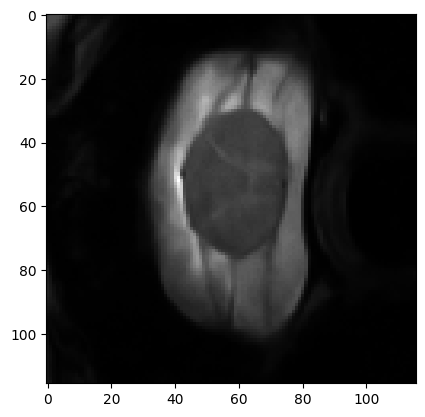

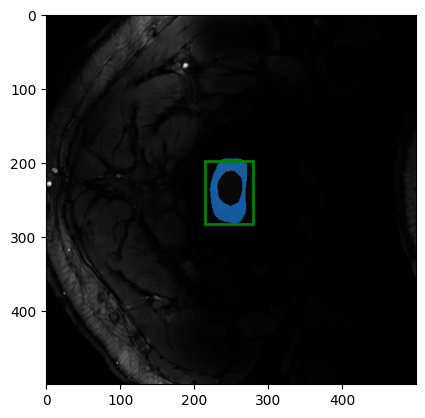

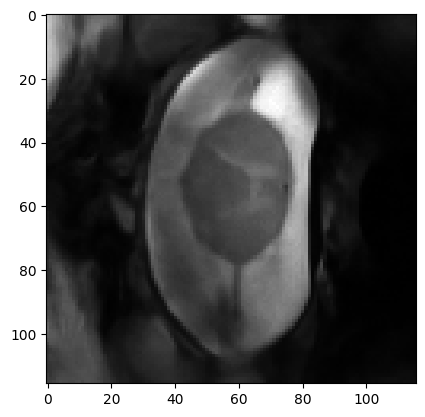

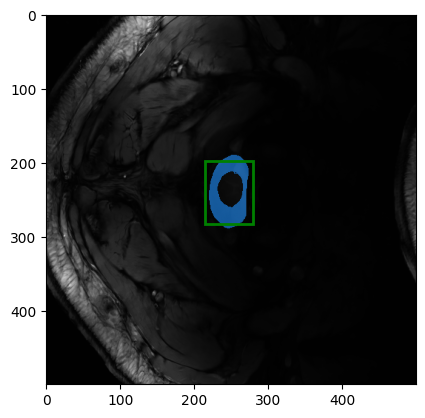

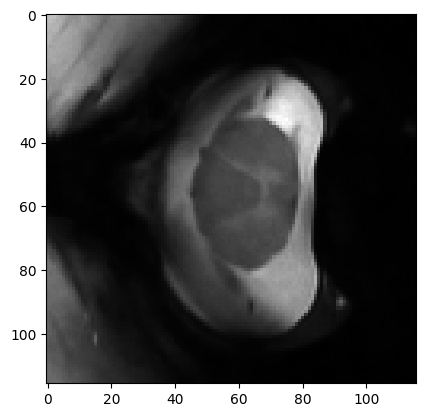

...

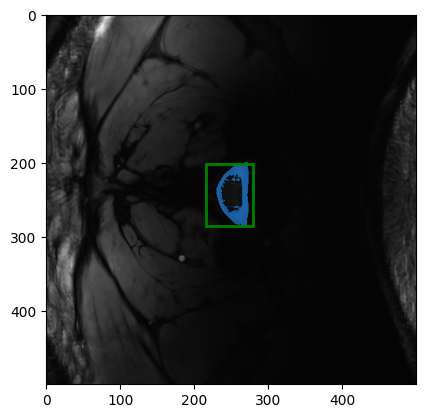

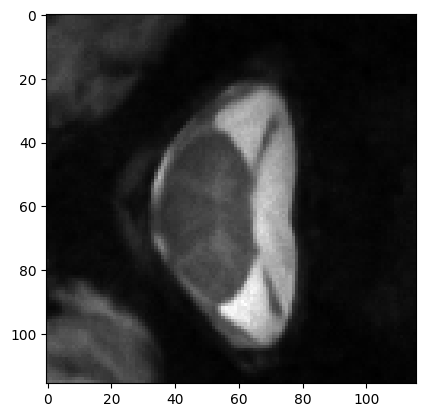

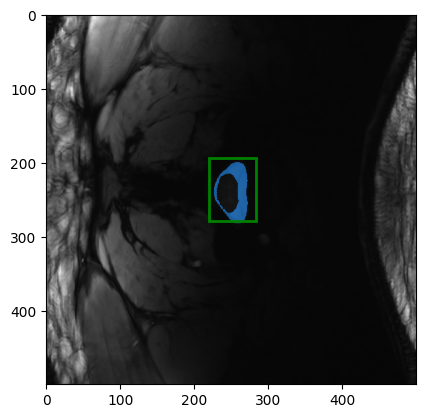

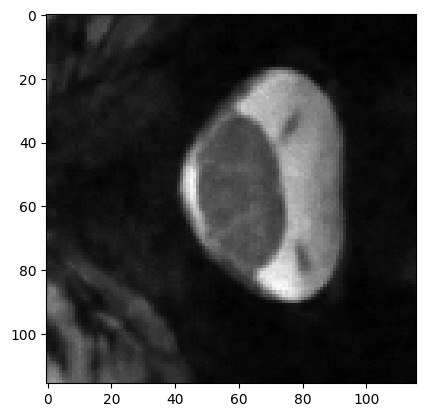

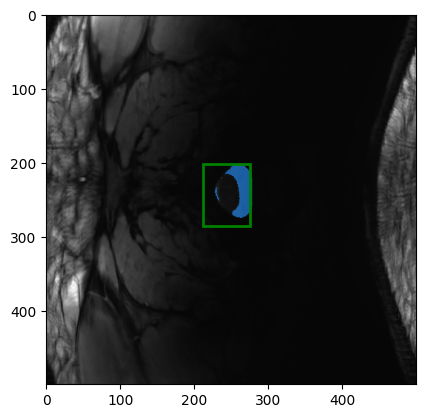

In [ ]:
image_data = nib.load('nl_session_2_medic.nii.gz' )
header_data = image_data.header
image_sc = np.array(image_data.get_fdata())
image_center = nib.load('nl_session_2_medic_centerline.nii.gz' )
image_center = np.array(image_center.get_fdata())

res=float(header_data["pixdim"][2])
n= int(30/res)
Size_X=(image_sc.shape)[0]
Size_Y=(image_sc.shape)[1]
Size_Z=(image_sc.shape)[2]
image_csf=np.zeros((Size_X,Size_Y,Size_Z))
for i in range ((image_sc.shape)[2]):
    image_sc_2d=image_sc[:,:,i]
    image_center_2d=image_center[:,:,i]
    for l in range(len(image_center_2d[:,0])):
        for m in range( len(image_center_2d[0,:])):
            if image_center_2d[l,m] == 1 :
                a,b=(l,m)
    cmin = a - int(n/2)
    cmax = a + int(n/2)
    dmin = b - int(n/2)
    dmax = b + int(n/2)
    factor_x = int(((dmax-dmin) - 16/res )/2)
    factor_y = int(((dmax-dmin) - 21/res )/2)
    input_box = np.array([dmin + factor_x, cmin + factor_y, dmax - factor_x ,cmax - factor_y])
    input_point =  np.array([[int(b), int(a)]])
    input_label = np.array([0])
    imgu8 = convert(image_sc_2d, 0, 255, np.uint8)
    image_sc_2d_rgb = cv2.merge([imgu8,imgu8,imgu8])
    predictor.set_image(image_sc_2d_rgb)
    masks, _, _ = predictor.predict(    point_coords=input_point,    point_labels=input_label,    box=input_box,     multimask_output=False,)
    image_csf[:,:,i]=(masks[0])
    plt.gray()
    plt.imshow(image_sc_2d[cmin:cmax,dmin:dmax])
    plt.show()
    plt.imshow(image_sc_2d)
    show_mask(masks[0], plt.gca())
    show_box(input_box, plt.gca())
    plt.show()

In [17]:
image_data = nib.load('mri.nii.gz' )
header_data = image_data.header
image_sc = (image_data.get_fdata())

In [19]:
input_box

array([ 99,  71, 117,  95])